In [7]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from utils.labels import map_class_to_rgb, adjust_mask
import segmentation_models as sm
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from utils.util import *
from arch.deeplabv3plus import Deeplabv3



# Paths and Constants

In [8]:
##### paths


base_data_dir = 'data'
saved_models = 'checkpoint'

train_path = os.path.join(base_data_dir, 'data')
test_path = os.path.join(base_data_dir, 'testing')

classes_path = os.path.join(base_data_dir, 'classes.csv')


iti_data_dir = os.path.join(base_data_dir, 'aroundITI')
single_frames_dir = os.path.join(base_data_dir, 'single_frames')
videos_dir = os.path.join(base_data_dir, 'videos')

output_images_dir = os.path.join(base_data_dir, 'output_images')
output_videos_dir = os.path.join(base_data_dir, 'output_videos')



## parmeters

batch_sz =8

num_classes = 29
DIM=256
seed = 1







# Read Labels file

In [9]:
classes = pd.read_csv(classes_path,index_col='name')

# data generators

In [10]:
# Data generator
train_generator_fn, val_generator_fn, train_length, validation_length = train_valid_generator(train_path, seed, batch_sz, DIM)

Found 662 images belonging to 1 classes.
Found 662 images belonging to 1 classes.
Found 38 images belonging to 1 classes.
Found 38 images belonging to 1 classes.


# Model (change here)

In [19]:
model = Deeplabv3(weights= 'pascal_voc' , input_shape=(DIM,DIM, 3),
                          classes=num_classes,activation='softmax', backbone='mobilenetv2')  

In [20]:
# deeplab_model.summary()

# freeze layers (optional)

In [21]:
## xception exit_flow_block2_separable_conv1_depthwise
## mobilenetv2 expanded_conv_16_project

freeze_model_layers(model,'expanded_conv_16_project')

# model compilation and fitting (you may change here if needed)

'deeplabv3plus'

In [25]:
from tensorflow.python.keras.optimizers import adam_v2

model_name=model._name

cp_name = os.path.join(saved_models,
                            model_name+'_epoch_{epoch:02d}_valLoss_{val_loss:.2f}.h5')

model_checkpoint = ModelCheckpoint(filepath=cp_name
                                   , monitor='val_loss',verbose=1, save_best_only=True)
reduce_lr = ReduceLROnPlateau(
    monitor = "val_loss", 
    patience = 20,
    verbose = 1, 
    factor = 0.2, 
    min_lr = 0.000001,
)


model.compile(
    optimizer= adam_v2.Adam(learning_rate=1e-4),
    # optimizer='Nadam',
    loss=sm.losses.cce_jaccard_loss,
    metrics=[sm.metrics.iou_score],
    
)

history = model.fit(
    train_generator_fn(),
    steps_per_epoch=train_length // batch_sz
  , validation_steps=validation_length // batch_sz,
   epochs=2,
   validation_data= val_generator_fn(),  
   callbacks=[model_checkpoint,reduce_lr]
)




82/82 [==============================] - 111s 1s/step - loss: 0.8594 - iou_score: 0.1659 - val_loss: 1.0135 - val_iou_score: 0.0818

Epoch 00001: val_loss improved from inf to 1.01347, saving model to saved_models\deeplabv3plus_epoch_01_valLoss_1.01.h5


C:\Users\20100\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


# plotting loss and MeaIou

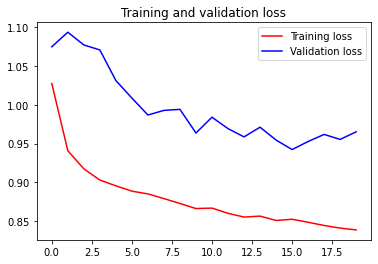

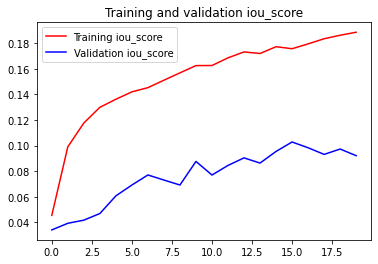

In [20]:
%matplotlib inline
import matplotlib.pyplot as plt
loss = history.history['loss']
val_loss = history.history['val_loss']
iou_score = history.history['iou_score']
val_iou_score = history.history['val_iou_score']

epochs = range(len(loss))

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.figure()

plt.plot(epochs, iou_score, 'r', label='Training iou_score')
plt.plot(epochs, val_iou_score, 'b', label='Validation iou_score')
plt.title('Training and validation iou_score')
plt.legend()

plt.show()

# loading Created Model

In [34]:
model_checkpoint.__dict__


{'validation_data': None,
 'model': <tensorflow.python.keras.engine.functional.Functional at 0x22abbaf6550>,
 '_chief_worker_only': False,
 '_supports_tf_logs': True,
 'monitor': 'val_loss',
 'verbose': 1,
 'filepath': 'saved_models\\deeplabv3plus_epoch_{epoch:02d}_valLoss_{val_loss:.2f}.h5',
 'save_best_only': True,
 'save_weights_only': False,
 'save_freq': 'epoch',
 'epochs_since_last_save': 0,
 '_batches_seen_since_last_saving': 0,
 '_last_batch_seen': 0,
 '_options': <tensorflow.python.saved_model.save_options.SaveOptions at 0x2295a70cb80>,
 'load_weights_on_restart': False,
 'period': 1,
 'monitor_op': <ufunc 'less'>,
 'best': 1.0134692192077637,
 'params': {'verbose': 1, 'epochs': 1, 'steps': 82},
 '_current_epoch': 0,
 '_write_filepath': 'saved_models\\deeplabv3plus_epoch_01_valLoss_1.01.h5'}

In [36]:
from keras.models import load_model

model = load_model(filepath=model_checkpoint._write_filepath, custom_objects={
    "categorical_crossentropy_plus_jaccard_loss":sm.losses.cce_jaccard_loss
    ,"iou_score":sm.metrics.iou_score})

# predicting Validation data

c:\Users\20100\Desktop\ITI\GP\data_semantics\organized\utils\util.py:275: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig , ax = plt.subplots(1,4,figsize=(16,16))


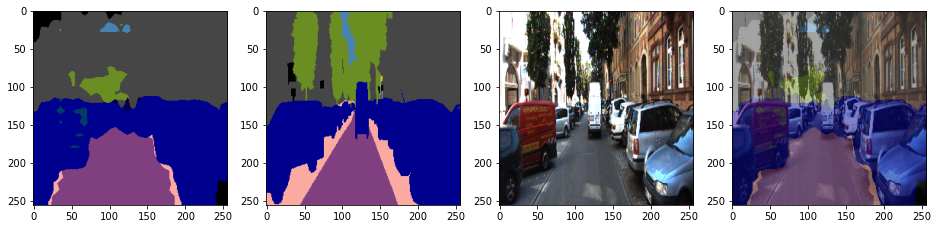

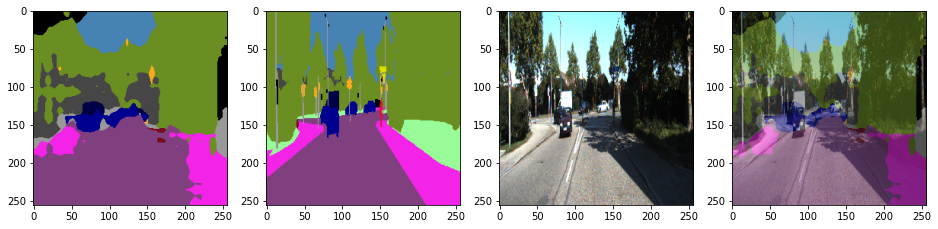

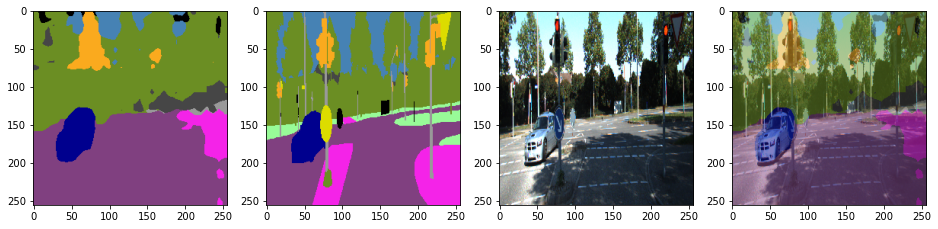

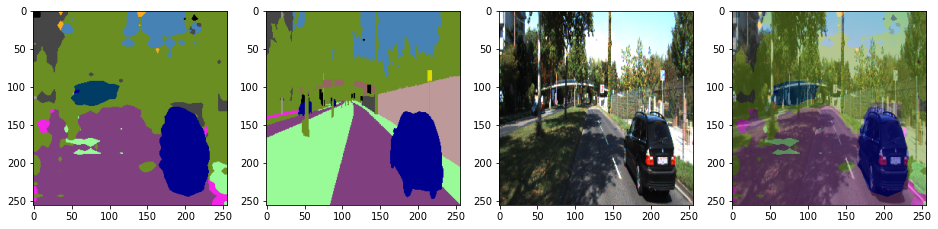

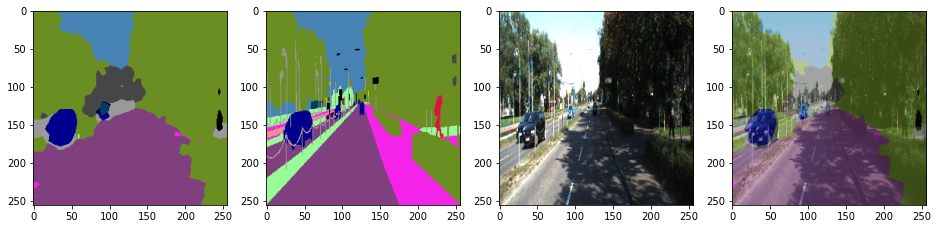

...

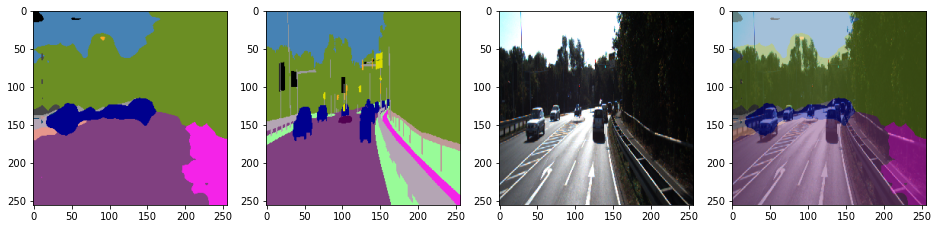

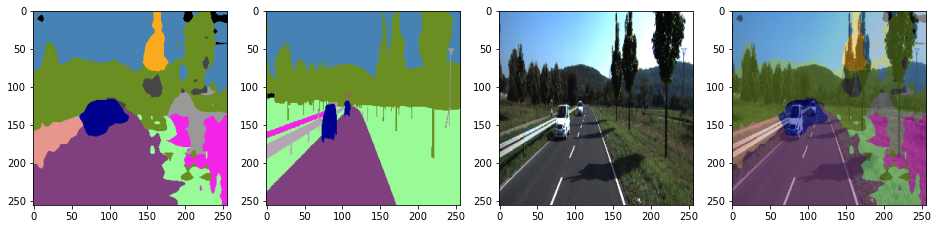

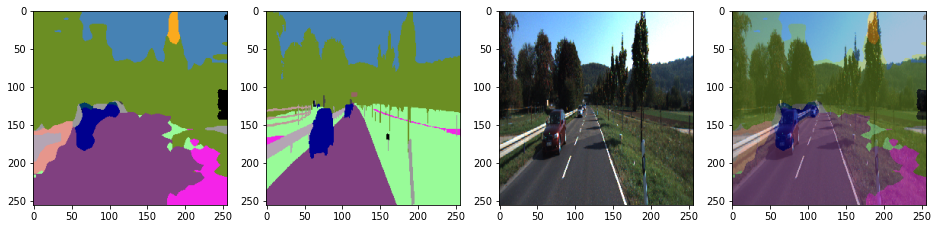

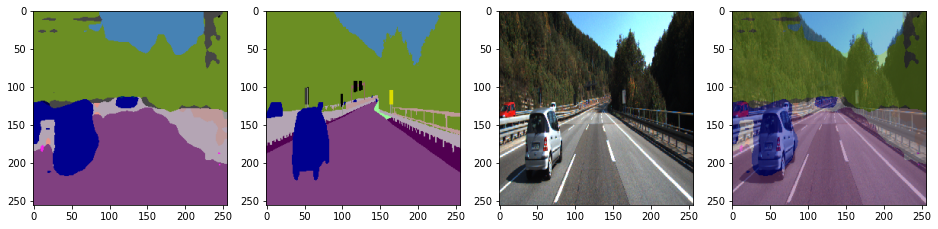

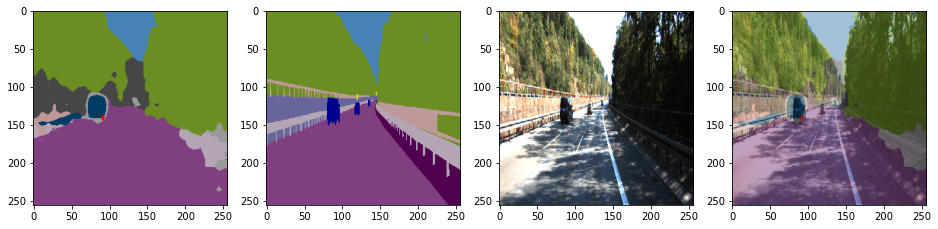

In [6]:
plot_predictions (train_path,model,DIM,mode='valid')

# predicting test data

c:\Users\20100\Desktop\ITI\GP\data_semantics\organized\utils\util.py:290: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig , ax = plt.subplots(1,3,figsize=(16,16))


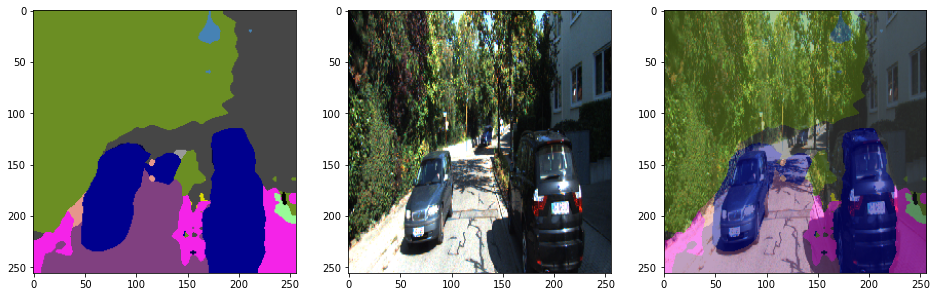

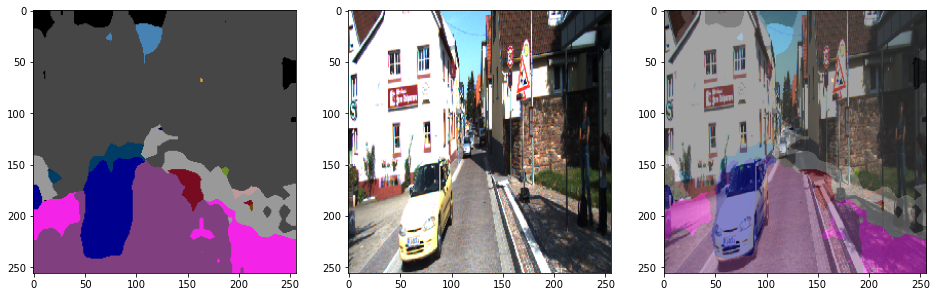

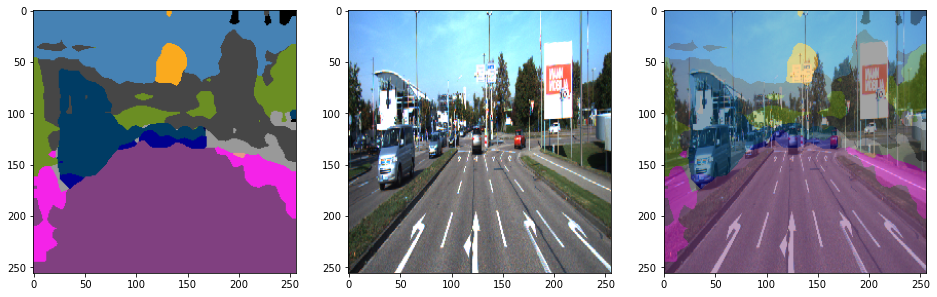

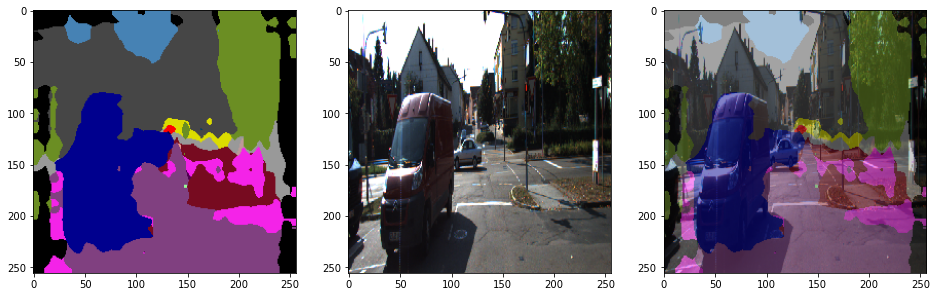

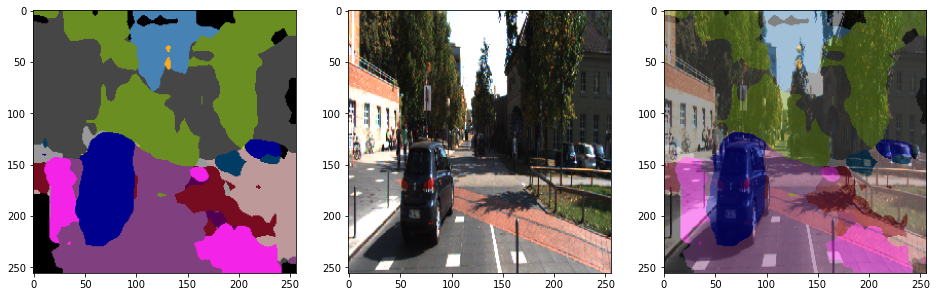

...

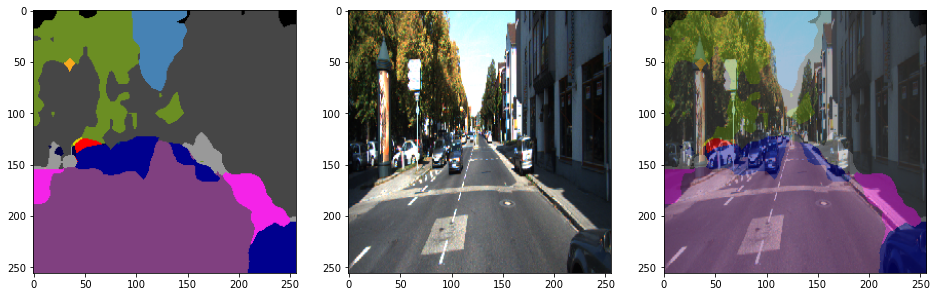

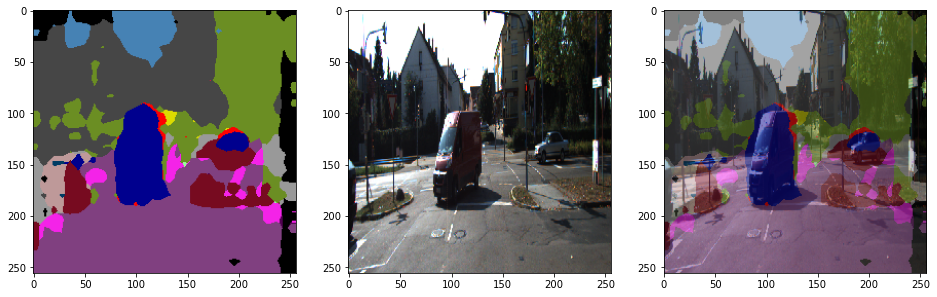

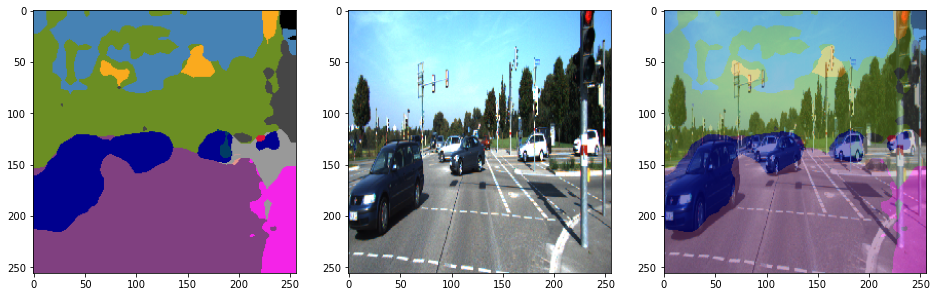

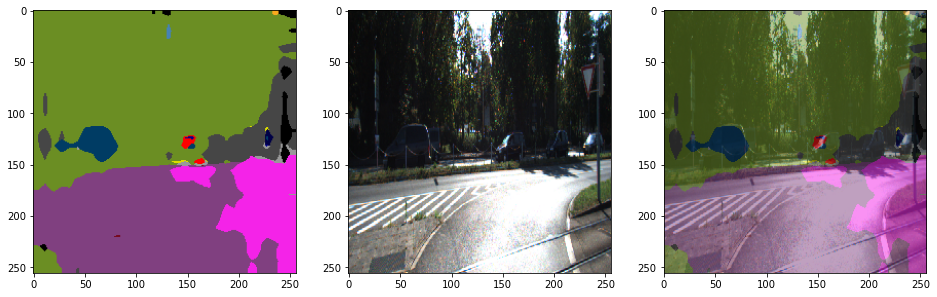

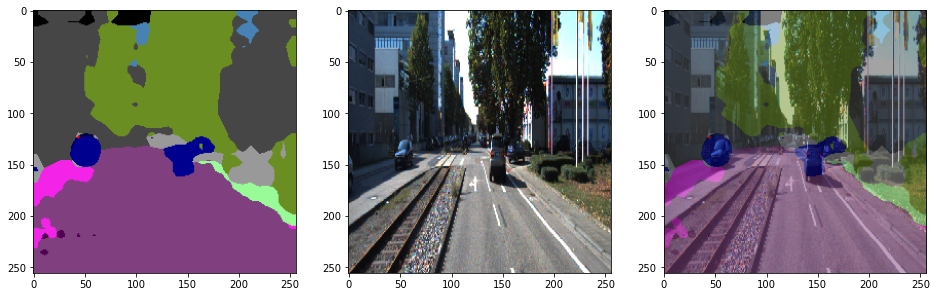

In [9]:
plot_predictions (test_path,model,DIM,mode='testing')

# predicting ITI Data

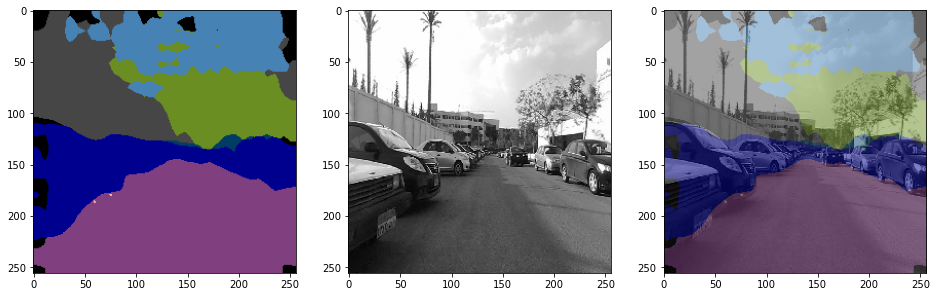

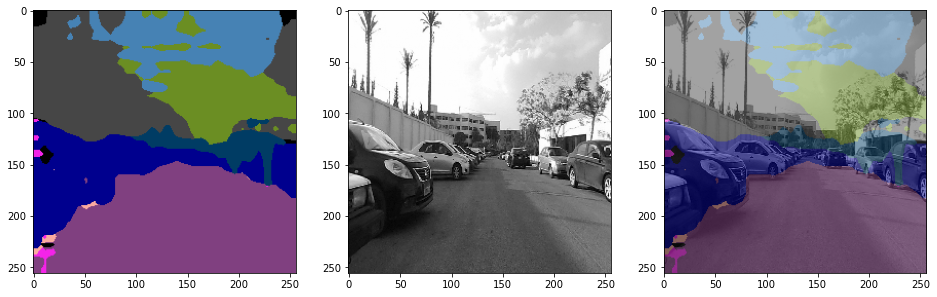

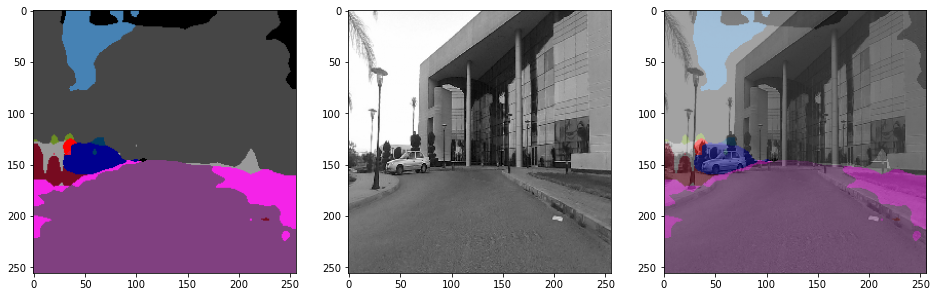

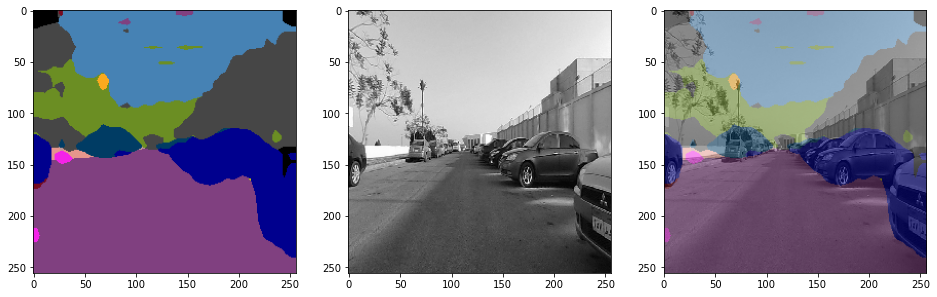

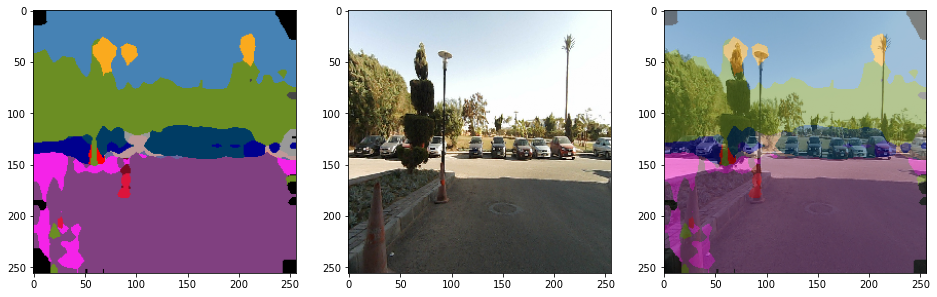

...

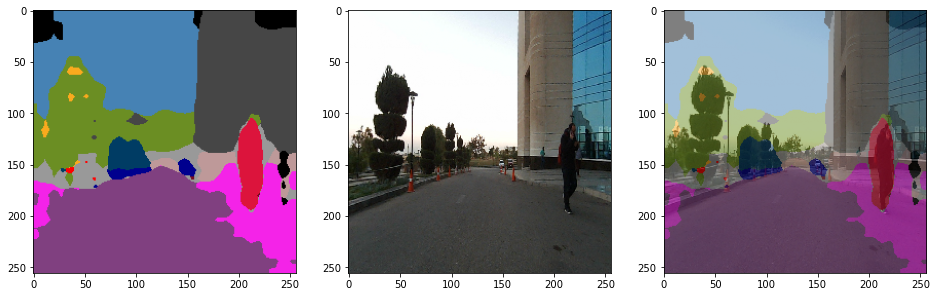

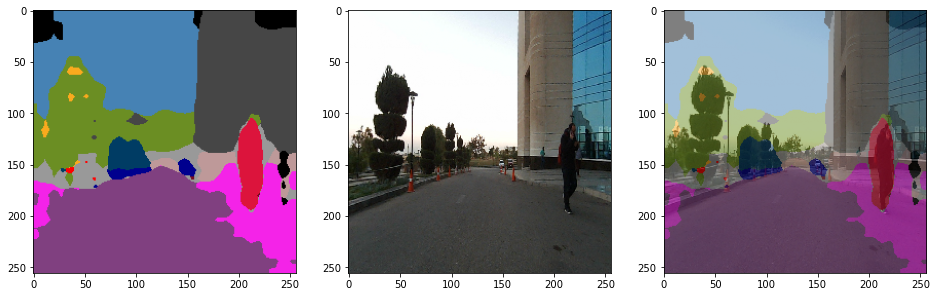

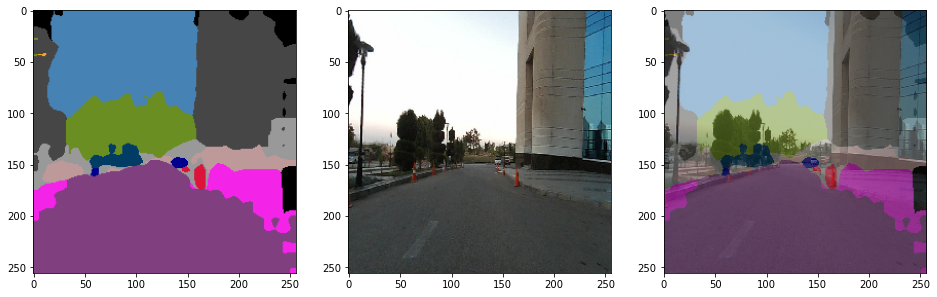

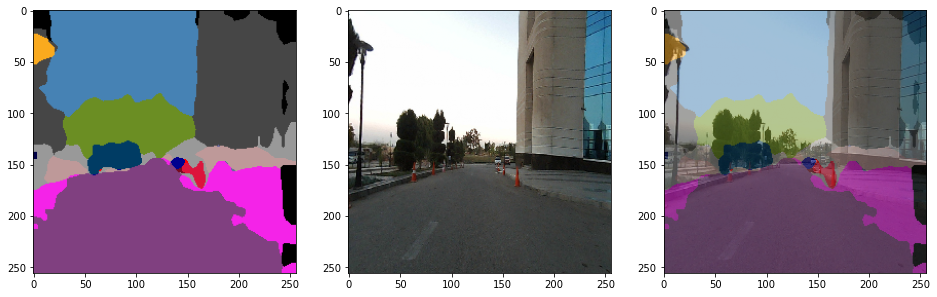

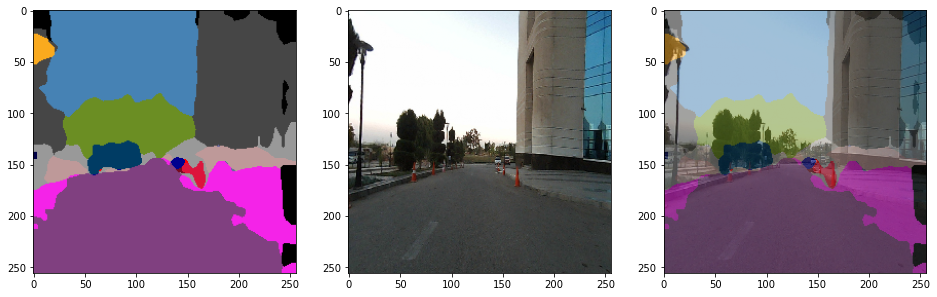

In [6]:
plot_predictions (iti_data_dir,model,DIM,mode='ITI')